In [2]:
import networkx as nx
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import powerlaw


Basic Analysis 


1. Number of nodes and edges

In [58]:
# Reading the Graph
G = nx.read_edgelist('facebook.txt')

#Number of nodes
nodes_count = G.number_of_nodes()
print("Number of nodes in the network: ", nodes_count)

# Number of edges
edges_count = G.number_of_edges()
print("Number of Egdes in the network: ", edges_count)


Number of nodes in the network:  4039
Number of Egdes in the network:  88234


Gaint Component

In [72]:
connected_components = sorted(nx.connected_components(G), key=len, reverse=True)
print(len(connected_components))

1


2. Diameter of graph

In [59]:
# Checking if the network is a fully connected network or not 
def connected_network(G):
    flag = nx.is_connected(G)
    
    if flag:
        print("The network is a fully connected graph")
        # Computing the diameter of the network
        d = nx.diameter(G)
        print("Diameter of the Network: ", d)
    else:
        print("The network is not connected")

connected_network(G)

The network is a fully connected graph
Diameter of the Network:  8


In [75]:
# density of the graph
density = nx.density(G)
print("Density of the graph: ",density)

Density of the graph:  0.010819963503439287


3. Shortest path

In [60]:
# Shortest Path of each node 
shortest_path = nx.shortest_path(G)
print("Shortest Paths:\n")
shortest_path



Shortest Paths:



{'0': {'0': ['0'],
  '1': ['0', '1'],
  '2': ['0', '2'],
  '3': ['0', '3'],
  '4': ['0', '4'],
  '5': ['0', '5'],
  '6': ['0', '6'],
  '7': ['0', '7'],
  '8': ['0', '8'],
  '9': ['0', '9'],
  '10': ['0', '10'],
  '11': ['0', '11'],
  '12': ['0', '12'],
  '13': ['0', '13'],
  '14': ['0', '14'],
  '15': ['0', '15'],
  '16': ['0', '16'],
  '17': ['0', '17'],
  '18': ['0', '18'],
  '19': ['0', '19'],
  '20': ['0', '20'],
  '21': ['0', '21'],
  '22': ['0', '22'],
  '23': ['0', '23'],
  '24': ['0', '24'],
  '25': ['0', '25'],
  '26': ['0', '26'],
  '27': ['0', '27'],
  '28': ['0', '28'],
  '29': ['0', '29'],
  '30': ['0', '30'],
  '31': ['0', '31'],
  '32': ['0', '32'],
  '33': ['0', '33'],
  '34': ['0', '34'],
  '35': ['0', '35'],
  '36': ['0', '36'],
  '37': ['0', '37'],
  '38': ['0', '38'],
  '39': ['0', '39'],
  '40': ['0', '40'],
  '41': ['0', '41'],
  '42': ['0', '42'],
  '43': ['0', '43'],
  '44': ['0', '44'],
  '45': ['0', '45'],
  '46': ['0', '46'],
  '47': ['0', '47'],
  '48': ['0'

In [61]:
# Shortest Path of the network ( Average Shortest Path)
avg_shortest_path = nx.average_shortest_path_length(G)
print("The average shortest path length of the network: ",avg_shortest_path, " i.e., ", round(avg_shortest_path,2))

The average shortest path length of the network:  3.6925068496963913  i.e.,  3.69


The average degree of the network:  43.68019801980198
The Maximum degree of the network:  1045
The Minimum degree of the network:  1
MAX to Min ratio:  1045.0


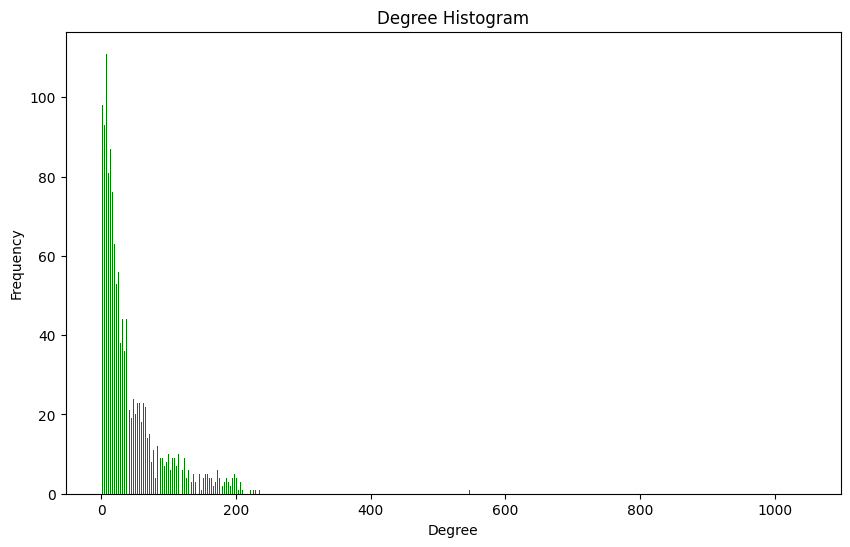

In [62]:
# degree of the network

degree = nx.degree(G)
#print(degree)
degrees_list = []
for node, degree in degree:
    degrees_list.append(degree)

average_degree = sum(degrees_list)/(len(degrees_list)+1)
max_degree = max(degrees_list)
min_degree = min(degrees_list)
print("The average degree of the network: ", average_degree)
print("The Maximum degree of the network: ", max_degree)
print("The Minimum degree of the network: ", min_degree)

print("MAX to Min ratio: ", max_degree/min_degree)

# As for the degree distribution of the network

degree_distribution = nx.degree_histogram(G)

plt.figure(figsize=(10,6))
plt.bar(range(len(degree_distribution)), degree_distribution, width = 0.5, color='green')
plt.xlabel('Degree')
plt.ylabel('Frequency')
plt.title('Degree Histogram')
plt.show()

In [95]:
deg =sorted(degrees_list)
deg[-10:]


[235, 245, 254, 291, 294, 347, 547, 755, 792, 1045]

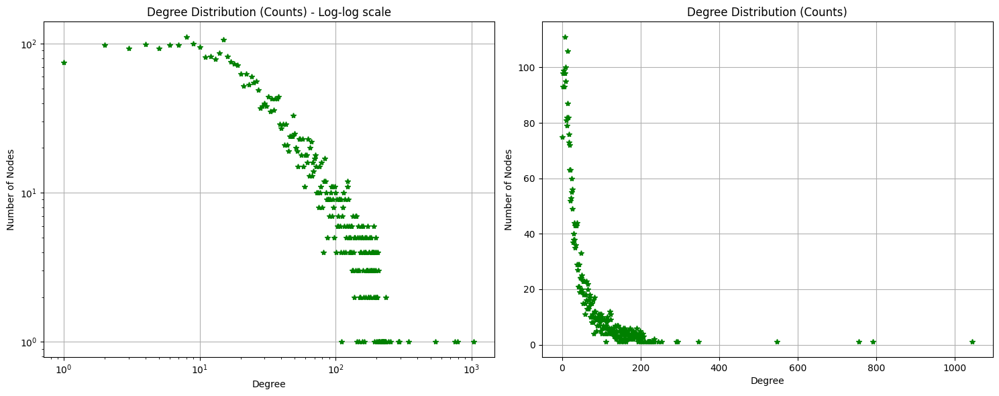

In [97]:

# Define the first plotting function
def degree_dist_plot1(G):
    degrees = dict(nx.degree(G))
    degree_values = sorted(set(degrees.values()))
    degree_counts = [list(degrees.values()).count(d) for d in degree_values]
    plt.figure(figsize=(15, 6))
    plt.subplot(1, 2, 1)  # Create subplot 1
    plt.loglog(degree_values, degree_counts, 'g*')
    plt.xlabel('Degree')
    plt.ylabel('Number of Nodes')
    plt.title('Degree Distribution (Counts) - Log-log scale')
    plt.grid(True)

# Define the second plotting function
def degree_dist_plot2(G):
    degrees = dict(nx.degree(G))
    degree_values = sorted(set(degrees.values()))
    degree_counts = [list(degrees.values()).count(d) for d in degree_values]

    plt.subplot(1, 2, 2)  # Create subplot 2
    plt.plot(degree_values, degree_counts, 'g*')
    plt.xlabel('Degree')
    plt.ylabel('Number of Nodes')
    plt.title('Degree Distribution (Counts)')
    plt.grid(True)

# Call the first plotting function
degree_dist_plot1(G)

# Call the second plotting function
degree_dist_plot2(G)

plt.tight_layout()  # Adjust layout to prevent overlapping
plt.show()


In [76]:

# Fit power-law distribution
fit = powerlaw.Fit(degrees_list, discrete=True, verbose=False)

alpha = fit.alpha
log_likelihood_ratio = fit.loglikelihood_ratio('power_law', 'exponential')[0]
p_value = fit.loglikelihood_ratio('power_law','exponential')[1]

print("Alpha: ", alpha)
print("p-value: ", p_value)
print("Log likelihood Ratio: ", log_likelihood_ratio)

Alpha:  2.510263154767209
p-value:  1.0109665086696757e-08
Log likelihood Ratio:  -109.70270292690296


Centrality Analysis


1. Degree Centrality

In [67]:
# Computing the degree centrality
dc = nx.degree_centrality(G)
dc

{'0': 0.08593363051015354,
 '1': 0.004210004952947003,
 '2': 0.0024764735017335313,
 '3': 0.004210004952947003,
 '4': 0.0024764735017335313,
 '5': 0.0032194155522535907,
 '6': 0.0014858841010401188,
 '7': 0.004952947003467063,
 '8': 0.001981178801386825,
 '9': 0.014115898959881128,
 '10': 0.0024764735017335313,
 '11': 0.00024764735017335313,
 '12': 0.00024764735017335313,
 '13': 0.007677067855373947,
 '14': 0.003714710252600297,
 '15': 0.00024764735017335313,
 '16': 0.002228826151560178,
 '17': 0.0032194155522535907,
 '18': 0.00024764735017335313,
 '19': 0.00396235760277365,
 '20': 0.003714710252600297,
 '21': 0.016097077761267953,
 '22': 0.0027241208519068845,
 '23': 0.004210004952947003,
 '24': 0.00396235760277365,
 '25': 0.017087667161961365,
 '26': 0.016840019811788013,
 '27': 0.0012382367508667657,
 '28': 0.0032194155522535907,
 '29': 0.0032194155522535907,
 '30': 0.004210004952947003,
 '31': 0.005695889053987122,
 '32': 0.0014858841010401188,
 '33': 0.0004952947003467063,
 '34': 

Highest degree centrality --> Node: 107, Centrality: 0.258791480931154
Lowest degree centrality  --> Node: 11, Centrality 0.00024764735017335313
Average degree centrality: 0.010819963503439833


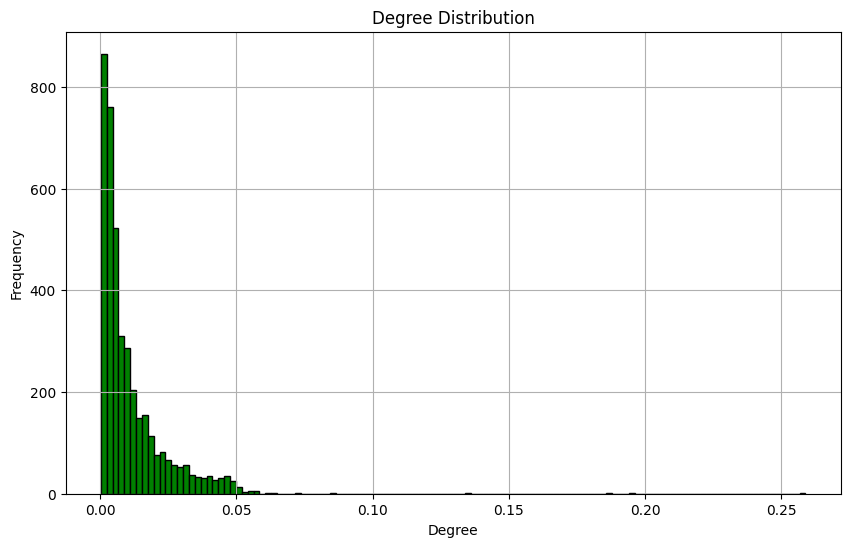

In [73]:
# Basic Degree centrality analysis
max_centrality_node = max(dc, key=dc.get)
min_centrality_node = min(dc, key=dc.get)
avg_centrality = sum(dc.values()) / len(dc)

print(f"Highest degree centrality --> Node: {max_centrality_node}, Centrality: {dc[max_centrality_node]}")
print(f"Lowest degree centrality  --> Node: {min_centrality_node}, Centrality {dc[min_centrality_node]}")
print(f"Average degree centrality: {avg_centrality}")

# Plotting degree distribution (Histogram)
degree_centrality_values = list(dc.values())
plt.figure(figsize=(10,6))
plt.hist(dc.values(), bins=120, color="green", edgecolor='black')
plt.title('Degree Distribution')
plt.xlabel('Degree')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

2. Closeness centrality

In [69]:
# Compute closeness centrality
cc = nx.closeness_centrality(G)
cc

{'0': 0.35334266713335666,
 '1': 0.2613761408505405,
 '2': 0.26125776397515527,
 '3': 0.2613761408505405,
 '4': 0.26125776397515527,
 '5': 0.2613084837895554,
 '6': 0.26119016817593793,
 '7': 0.2747686445291236,
 '8': 0.2612239617026782,
 '9': 0.2620546433902265,
 '10': 0.26125776397515527,
 '11': 0.26110572259941806,
 '12': 0.26110572259941806,
 '13': 0.26161321671525756,
 '14': 0.2613423079412336,
 '15': 0.26110572259941806,
 '16': 0.2612408617454875,
 '17': 0.2613084837895554,
 '18': 0.26110572259941806,
 '19': 0.2613592233009709,
 '20': 0.2613423079412336,
 '21': 0.2756125861715924,
 '22': 0.2612746683921061,
 '23': 0.2613761408505405,
 '24': 0.2613592233009709,
 '25': 0.26225888160031174,
 '26': 0.26224184959085595,
 '27': 0.2611732746911584,
 '28': 0.2613084837895554,
 '29': 0.2613084837895554,
 '30': 0.2613761408505405,
 '31': 0.2614776921582594,
 '32': 0.26119016817593793,
 '33': 0.26112260734609416,
 '34': 0.3033125516412529,
 '35': 0.26112260734609416,
 '36': 0.26127466839210

Highest closeness centrality --> Node: 107, Centrality: 0.45969945355191255
Lowest closeness centrality  --> Node: 692, Centrality: 0.1782545358230698
Average closeness centrality: 0.2761677635668379


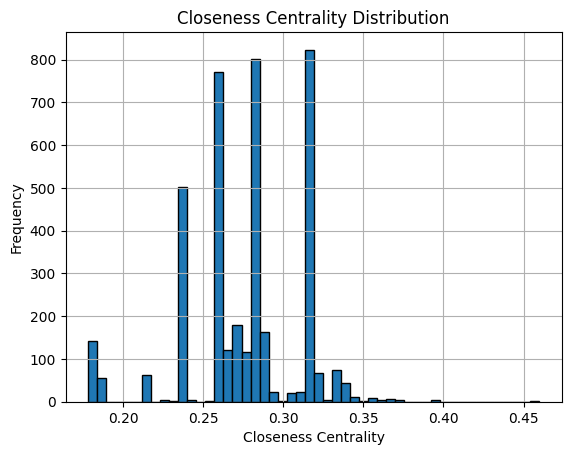

In [70]:
# Basic analysis
max_closeness_node = max(cc, key=cc.get)
min_closeness_node = min(cc, key=cc.get)
avg_closeness = sum(cc.values()) / len(cc)

print(f"Highest closeness centrality --> Node: {max_closeness_node}, Centrality: {cc[max_closeness_node]}")
print(f"Lowest closeness centrality  --> Node: {min_closeness_node}, Centrality: {cc[min_closeness_node]}")
print(f"Average closeness centrality: {avg_closeness}")

# Plot closeness centrality distribution
closeness_values = list(cc.values())
plt.hist(closeness_values, bins=50, edgecolor='black')
plt.title('Closeness Centrality Distribution')
plt.xlabel('Closeness Centrality')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

3. Betweenness centrality

In [ ]:
# Computing betweenness centrality
bc = nx.betweenness_centrality(G)
bc

{'0': 0.14630592147442917,
 '1': 2.7832744209034606e-06,
 '2': 7.595021178512074e-08,
 '3': 1.6850656559280464e-06,
 '4': 1.8403320547933104e-07,
 '5': 2.205964164092193e-06,
 '6': 2.4537760730577472e-08,
 '7': 0.0001702984836730339,
 '8': 2.7604980821899654e-07,
 '9': 1.6454236303026905e-05,
 '10': 4.986739552037655e-08,
 '11': 0.0,
 '12': 0.0,
 '13': 1.7622717578436846e-06,
 '14': 5.582871686568508e-07,
 '15': 0.0,
 '16': 1.9979459275532697e-07,
 '17': 4.1066669000480344e-07,
 '18': 0.0,
 '19': 5.062957964075819e-06,
 '20': 6.793693332142838e-07,
 '21': 0.0009380243844653233,
 '22': 6.703002200833232e-07,
 '23': 6.860348937590618e-06,
 '24': 1.3673472422981514e-07,
 '25': 5.38808313945586e-05,
 '26': 1.935436798204632e-05,
 '27': 3.067220091322184e-08,
 '28': 3.812160659244892e-07,
 '29': 1.3954817951917517e-06,
 '30': 1.3694627409316544e-06,
 '31': 4.932641252790837e-06,
 '32': 0.0,
 '33': 0.0,
 '34': 0.0036020881281963652,
 '35': 0.0,
 '36': 2.726417858953052e-08,
 '37': 0.0,
 '38'

Highest betweenness centrality --> Node: 107, Centrality: 0.4805180785560152
Lowest betweenness centrality --> Node: 11, Centrality: 0.0

Average betweenness centrality: 0.0006669573568730213


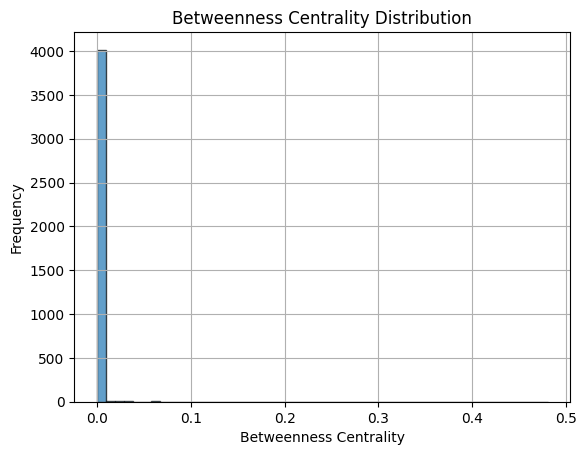

In [ ]:
# Basic analysis
max_betweenness_node = max(bc, key=bc.get)
min_betweenness_node = min(bc, key=bc.get)
avg_betweenness = sum(bc.values()) / len(bc)

# Print statements
print(f"Highest betweenness centrality --> Node: {max_betweenness_node}, Centrality: {bc[max_betweenness_node]}")
print(f"Lowest betweenness centrality --> Node: {min_betweenness_node}, Centrality: {bc[min_betweenness_node]}\n")
print(f"Average betweenness centrality: {avg_betweenness}")

# Plot betweenness centrality distribution
betweenness_centrality_values = list(bc.values())
plt.hist(betweenness_centrality_values, bins=50, edgecolor='black', alpha=0.7)
plt.title('Betweenness Centrality Distribution')
plt.xlabel('Betweenness Centrality')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

Clustering coefficient analysis

Highest clustering coefficient --> Node: 32, Clustering Coefficient: 1.0
Lowest clustering coefficient  --> Node: 11, Clustering Coefficient: 0
Average clustering coefficient: 0.6055467186200876


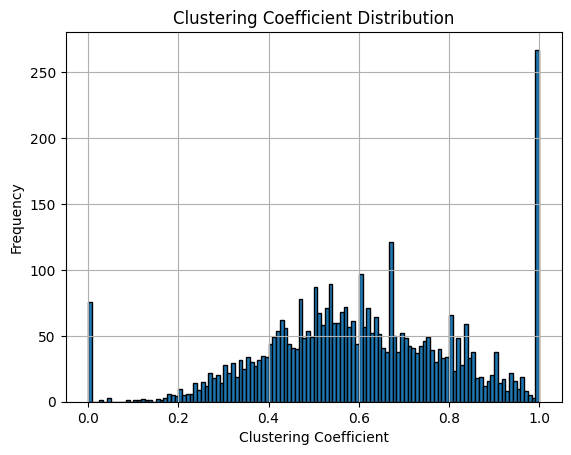

In [ ]:
clustering_coefficient = nx.clustering(G)

# Compute average clustering coefficient
avg_clustering_coefficient = nx.average_clustering(G)

# Find the node with the maximum clustering coefficient
max_cc_node = max(clustering_coefficient, key=clustering_coefficient.get)
max_cc_value = clustering_coefficient[max_cc_node]

# Find the node with the minimum clustering coefficient
min_cc_node = min(clustering_coefficient, key=clustering_coefficient.get)
min_cc_value = clustering_coefficient[min_cc_node]

# Print statements
print(f"Highest clustering coefficient --> Node: {max_cc_node}, Clustering Coefficient: {max_cc_value}")
print(f"Lowest clustering coefficient  --> Node: {min_cc_node}, Clustering Coefficient: {min_cc_value}")
print(f"Average clustering coefficient: {avg_clustering_coefficient}")

plt.hist(clustering_coefficient.values(), bins=120, edgecolor='black')
plt.title('Clustering Coefficient Distribution')
plt.xlabel('Clustering Coefficient')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

In [ ]:
cc_zero = sum(1 for cc in clustering_coefficient.values() if cc == 0)
cc_one = sum(1 for cc in clustering_coefficient.values() if cc==1)

print(f"Number of nodes with clustering coefficient equal to 0: {cc_zero}")
print(f"Number of nodes with clustering coefficient equal to 1: {cc_one}")

Number of nodes with clustering coefficient equal to 0: 76
Number of nodes with clustering coefficient equal to 1: 267


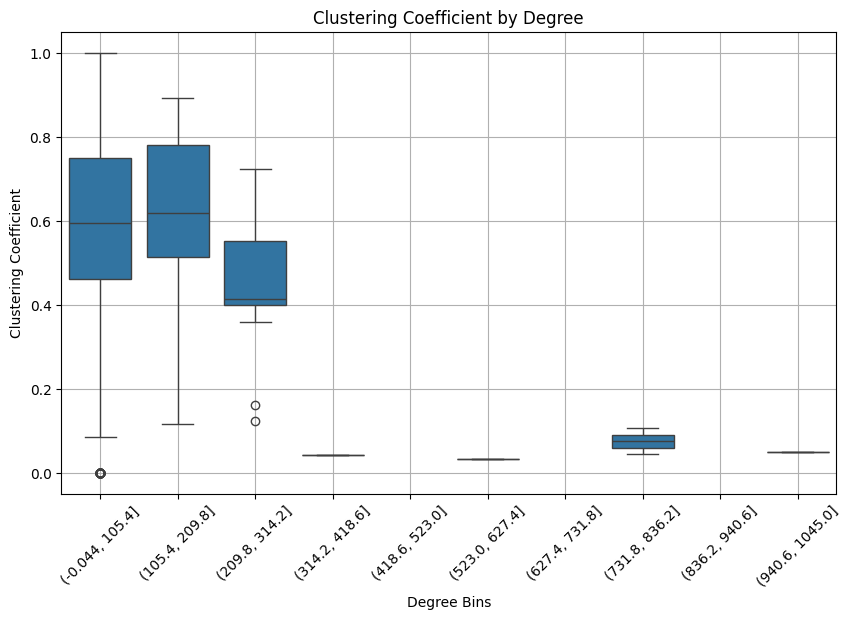

In [ ]:
degrees = nx.degree(G)

# Create a DataFrame to store the data
import pandas as pd
df = pd.DataFrame({'Node': list(clustering_coefficient.keys()), 'Degree': [degrees[node] for node in clustering_coefficient], 'Clustering Coefficient': list(clustering_coefficient.values())})

# Create degree bins
bins = pd.cut(df['Degree'], bins=10)

# Plot
plt.figure(figsize=(10, 6))
sns.boxplot(x=bins, y='Clustering Coefficient', data=df)
plt.title('Clustering Coefficient by Degree')
plt.xlabel('Degree Bins')
plt.ylabel('Clustering Coefficient')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

Watts-Strogatz model

In [3]:
def average_degree(G):
    degree = nx.degree(G)
    #print(degree)
    degrees_list = []
    for node, degree in degree:
        degrees_list.append(degree)

    average = sum(degrees_list)/(len(degrees_list)+1)
    max_degree = max(degrees_list)
    min_degree = min(degrees_list)
    print("The average degree of the network: ", average)
    print("The Maximum degree of the network: ", max_degree)
    print("The Minimum degree of the network: ", min_degree)

    print("MAX to Min ratio: ", max_degree/min_degree)

In [5]:
# Parameters for Watts-Strogatz model 
n = 4039 # number of nodes ( since we have 4039 nodes in our case)
k = 15   # each nodes connection to k nearest neighbours
p1 = 0.1  # probablity of rewiring the edges
p2 = 0.5
p3 = 0.01

G1 = nx.watts_strogatz_graph(n, k, p1)
G2 = nx.watts_strogatz_graph(n,k, p2)
G3 = nx.watts_strogatz_graph(n,k, p3)

print("Random Model 1\n")
print("Number of nodes :", len(G1.nodes()))
print("Number of edges:", len(G1.edges()))
print("Diameter of the Network: ",nx.diameter(G1))
average_degree(G1)
print("Average clustering coefficient:", nx.average_clustering(G1))
print("Average shortest path length:", nx.average_shortest_path_length(G1), "\n")


print("Random Model 2\n")
print("Number of nodes :", len(G2.nodes()))
print("Number of edges:", len(G2.edges()))
print("Diameter of the Network: ",nx.diameter(G2))
average_degree(G2)
print("Average clustering coefficient:", nx.average_clustering(G2))
print("Average shortest path length:", nx.average_shortest_path_length(G2), "\n")

print("Random Model 3\n")
print("Number of nodes :", len(G3.nodes()))
print("Number of edges:", len(G3.edges()))
print("Diameter of the Network: ",nx.diameter(G3))
average_degree(G3)
print("Average clustering coefficient:", nx.average_clustering(G3))
print("Average shortest path length:", nx.average_shortest_path_length(G3), "\n")

Random Model 1

Number of nodes : 4039
Number of edges: 28273
Diameter of the Network:  7
The average degree of the network:  13.996534653465346
The Maximum degree of the network:  19
The Minimum degree of the network:  10
MAX to Min ratio:  1.9
Average clustering coefficient: 0.5062821813420452
Average shortest path length: 4.5787643041023625 

Random Model 2

Number of nodes : 4039
Number of edges: 28273
Diameter of the Network:  5
The average degree of the network:  13.996534653465346
The Maximum degree of the network:  23
The Minimum degree of the network:  8
MAX to Min ratio:  2.875
Average clustering coefficient: 0.0898362298846004
Average shortest path length: 3.5769365329935066 

Random Model 3

Number of nodes : 4039
Number of edges: 28273
Diameter of the Network:  19
The average degree of the network:  13.996534653465346
The Maximum degree of the network:  17
The Minimum degree of the network:  11
MAX to Min ratio:  1.5454545454545454
Average clustering coefficient: 0.6723939

In [ ]:
n = 4039  # Number of nodes
p = 0.1  # Probability of edge creation

# Generate ER random graph
Ger = nx.erdos_renyi_graph(n, p)

print("Number of nodes:", len(Ger.nodes()))
print("Number of edges:", len(Ger.edges()))
print("Average clustering coefficient:", nx.average_clustering(Ger))
print("Average shortest path length:", nx.average_shortest_path_length(Ger))


Number of nodes: 4039
Number of edges: 816037
Average clustering coefficient: 0.10006402845218548
Average shortest path length: 1.8999309726697635
